In [46]:
from groove.embedding import smooth_power, smooth_power_deriv, butter_bandpass_filter,butter_hipass_filter,butter_lowpass_filter, load_bar_embedding_freq

In [4]:

from IPython.display import Audio

In [5]:
import matplotlib.pyplot as plt
import numpy as np

In [6]:
import librosa

In [7]:
file,ext= "09 D'Angelo - Spanish Joint",'m4a'
samples, sr = librosa.load(f'inputs/{file}.{ext}')

/var/folders/5s/5m5dcls13_scn11gch5x16680000gn/T/ipykernel_63236/677887972.py:2: UserWarning: PySoundFile failed. Trying audioread instead.
  samples, sr = librosa.load(f'inputs/{file}.{ext}')
/Users/duncan/mambaforge/envs/groove/lib/python3.11/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


In [8]:
display(Audio(data=samples,rate=sr))

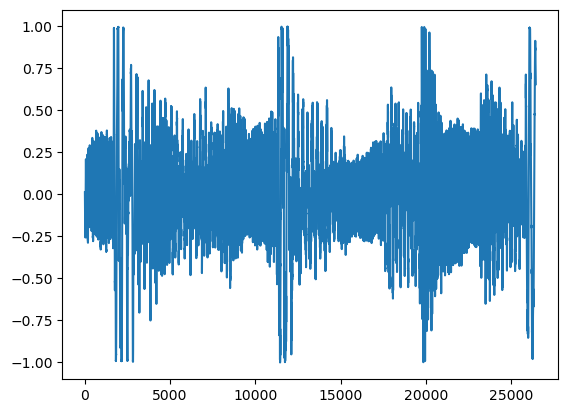

In [37]:
clip=samples[int(50.80*sr):(52*sr)]
plt.plot(clip)
display(Audio(data=clip,rate=sr))

In [52]:
def plot_power_and_deriv(clip,window=.05):


  power= smooth_power(clip,sr,window=window)
  dpower = np.clip(smooth_power_deriv(clip,sr,window=window), 0,None)
  # dlogpower = dpower/power
  # d2power = smooth_power_deriv(clip,sr,window=window,deriv=2)
  # d3power = smooth_power_deriv(clip,sr,window=window,deriv=3)
  plt.figure(figsize=(20,10))
  plt.plot(clip/np.max(clip),label='Audio samples')
  plt.plot(power/np.max(power),label='Power')
  plt.plot(dpower/np.max(dpower), label='Power 1st derivative')

  # plt.plot(dlogpower/np.max(dlogpower), label='Log(Power) 1st derivative')
  # plt.plot(d2power/np.max(d2power), label='Power 2nd derivative')
  # plt.plot(d3power/np.max(d3power), label='Power 3rd derivative')
  plt.legend()

In [53]:
locut=200
midrange=[400,5000]
hicut=5000
framerate=sr
bp_clips=[butter_lowpass_filter(clip, locut, framerate),
butter_bandpass_filter(clip, *midrange, framerate),
butter_hipass_filter(clip, hicut, framerate)]

In [54]:
bp_clips[0].shape

(26460,)

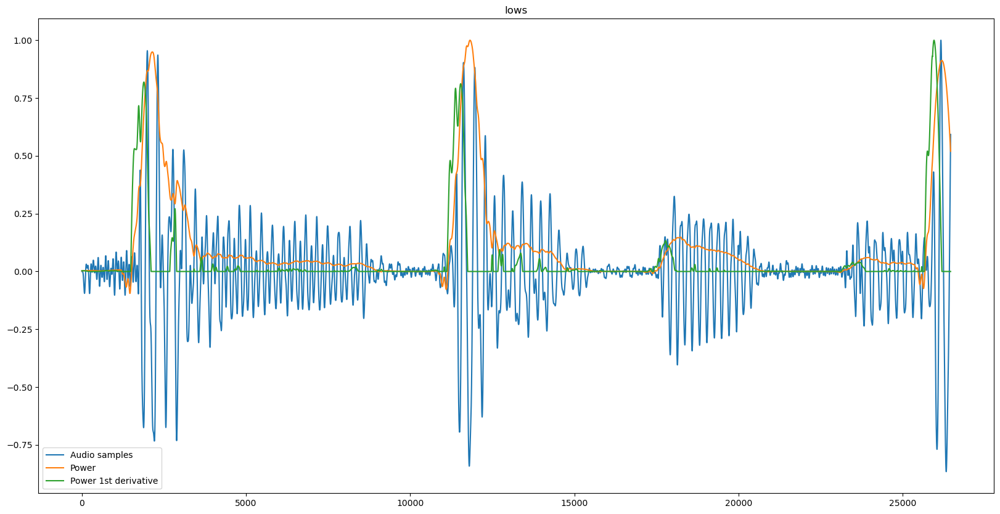

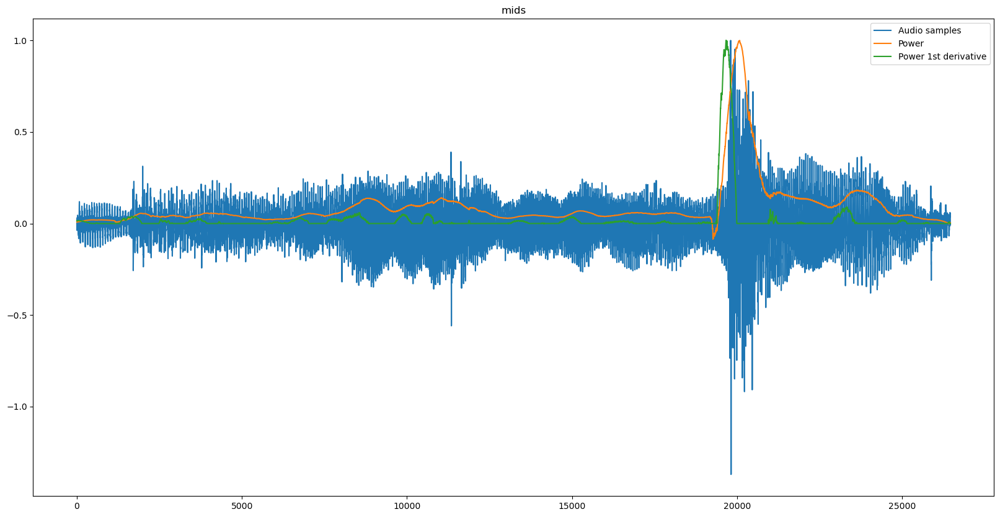

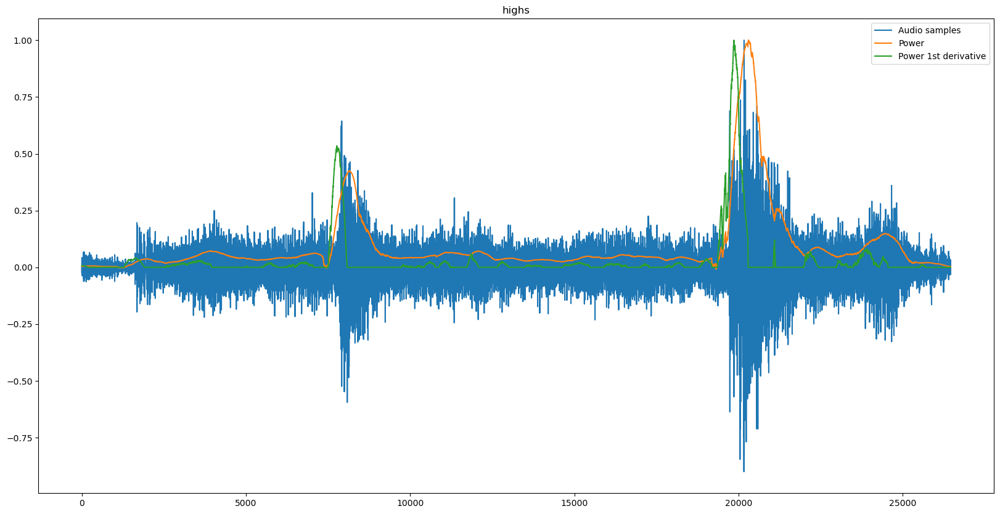

In [55]:
for i,bp_clip in enumerate(bp_clips): 
  plot_power_and_deriv(bp_clip)
  plt.title(['lows','mids','highs'][i])
  plt.show()

In [47]:
load_bar_embedding_freq()

<function groove.embedding.load_bar_embedding_freq(file, divisions, weights, process: Callable = <function get_freq_segmented_powers at 0x13babd440>, kernel_width=30, ext='mp3', square=True)>